# winter 2022 week03

## goals:

reload the data
run util/load_data.py convert_all() function -- which loads everything and converts it to parquet

## todo
- ~add PIPA to list of interesting ones (57 -> 58)~
- ~figure out how to get the thing to run faster (try to just use geopoints_sampled in analyze)~
- ~final count of reduced fishing~
- run the analyze thing over those 7/8
- make those charts of in/out fishing effort of individual ships for those 7/8
- make pictures of before/after fishing effort of individual ships for those 7/8 (could use consistent colors)

THEN:
- ~make ~table~ scatter-plot of (low, low), (low, high), (high, low), (high, high). etc. of the 171~
- ~make table of (?, low), (?, high) of all the other ones~
- try to categorize the mpas (sum up area and #, etc.)

### of the 171:
- about 14 showed notable decrease in both # hours and %
- significant number (>100) of the 171 had no effort in before or after
- very small number (3) showed a modest increase in % internal effort
(should I quantify this by marine area?)
- any sort of before/after pictures helpful? (at least make the before/after effort plots)
- decide on criteria: % decrease by at least something
- for all the matching ones, do a before/after



AND THEN:
- compare to the paper about 5 MPAs
- email Dan to show him everything
- title: what can GFW data tell us about the true protection of MPA?
- two effective scenarios: (high, low) and (low, low) ~= (?, low)


## notes:



In [1]:
%load_ext autoreload

In [2]:
%autoreload 2

In [3]:
cd /Users/brendan/Documents/projects/mpa_project/gfw_research

/Users/brendan/Documents/projects/mpa_project/gfw_research


In [14]:
import numpy as np
import pandas
from datetime import datetime
import matplotlib.pyplot as plt
import os
import pywdpa
import geopandas
import contextily as ctx
from shapely import geometry
from shapely import ops
import pretty_html_table
import cProfile

import util

pandas.set_option('display.max_columns', None)
pandas.set_option('display.max_rows', None)

In [6]:
DATA_PATH = "/Users/brendan/Documents/projects/mpa_project/gfw_research/data/"
FILENAME = "mpatlas_20201223_clean/mpatlas_20201223_clean.shp"

#mpas = geopandas.read_file(DATA_PATH + FILENAME)
# util.load_mpatlas_mpas()
mpas = geopandas.read_parquet("data/mpas/mpatlas.parquet")

In [7]:
def load_year(year):
    year = str(year)
    print(f'\r reading year {year}', end='')
    return pandas.read_parquet("data/points/" + year + ".parquet")

In [8]:
points_by_year = {
    year : load_year(year)
    for year in range(2012, 2021)
}

 reading year 2020

In [9]:
# sample the points here before converting to geo
# use the sampled points to find the mmsi that are interesting
# only then should we get all of the points of relevent mmsi

SAMPLE_RATIO = 100
points_sampled = []
for year, points in points_by_year.items():
    print(f'\rsampling {str(year)}... ', end='')
    points_sampled.append(points.sample(frac=1/SAMPLE_RATIO))
print('done.')
points_sampled = pandas.concat(points_sampled)
print("converting to geo...  ", end='')
geopoints_sampled = util.convert_to_geo(points_sampled, box=True)
print("done.")


sampling 2020... done.
converting to geo...  done.


In [62]:
mpas[mpas['no_take'] == 'All']['implemente'].value_counts()

1    1056
0      30
Name: implemente, dtype: int64

In [12]:
no_take = mpas[(mpas['no_take']=='All') & (mpas['implemente'])]
of_interest_frame = no_take[
    ((no_take['status_yea'] > 2012) | (no_take['implementa'] > '2012-01-01')) & no_take['implemente']]
of_interest = [
    (None, 555512002, 'Phoenix Island Protected Area', '2015-01-01')
]
# for i, row in no_take[no_take['status_yea'] > 2012].iterrows():
for i, row in of_interest_frame.iterrows():
    date = row['implementa']
    if date is None:
        date = str(row['status_yea'])
    of_interest.append(
        (row['mpa_id'], row['wdpa_id'], row['name'], date)
    )

np.random.shuffle(of_interest)

35/127 14978 555556866 Abrolhos - National Park Zone 2018-07-01                                          -19                           

/opt/homebrew/lib/python3.9/site-packages/geopandas/plotting.py:661: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)


127/127 68817259 0 Natural Park of the Coral Sea - Nature Reserve 2018-08-01                                                                      

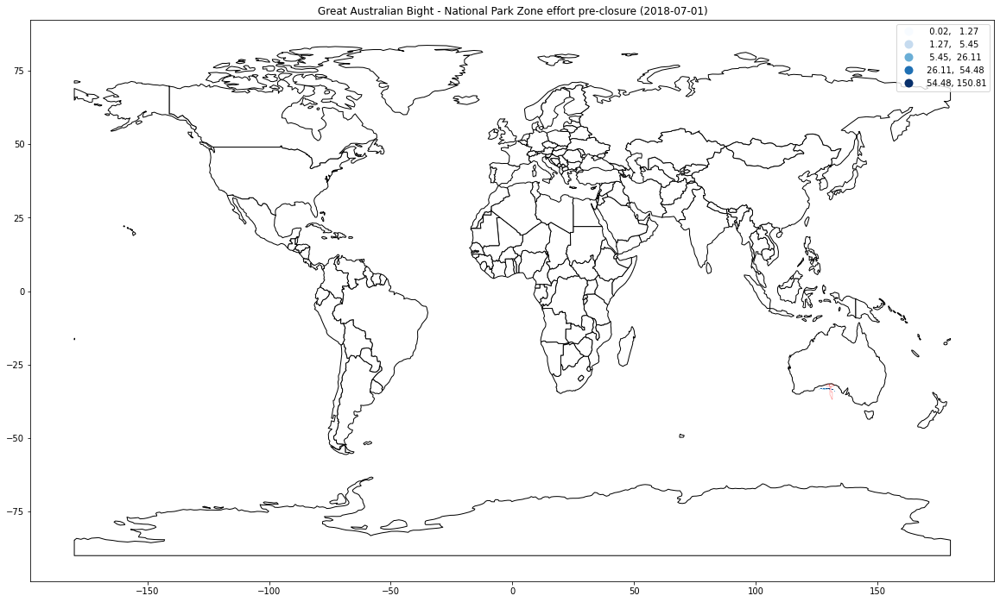

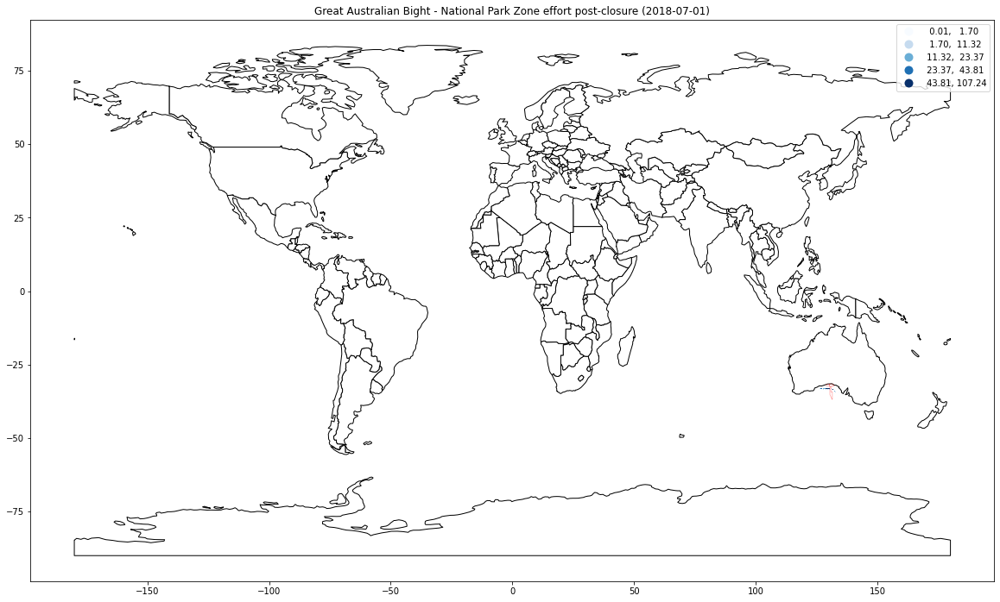

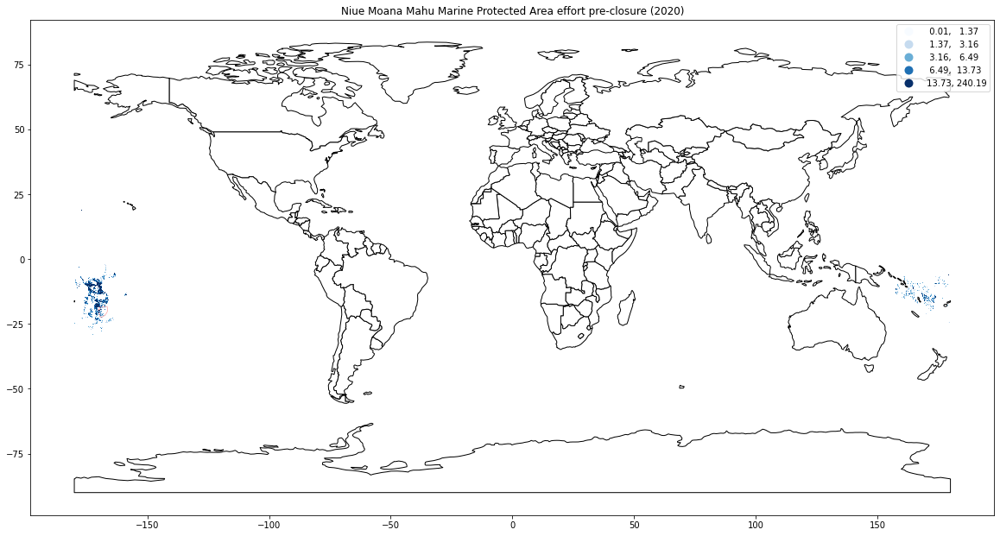

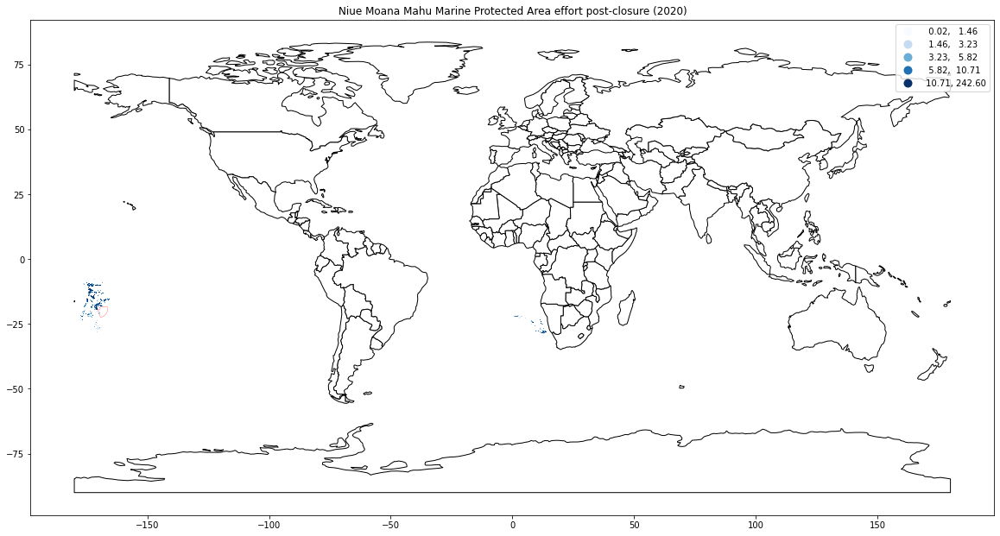

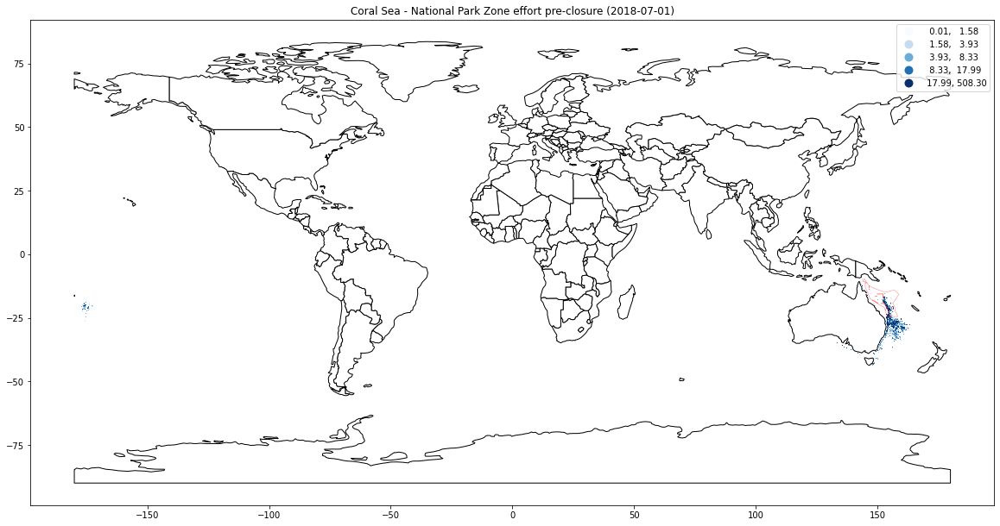

...

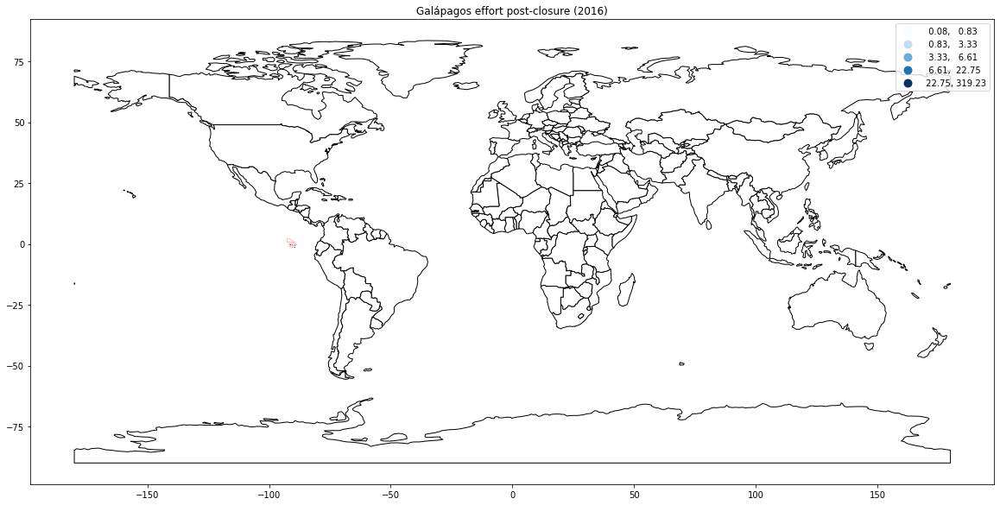

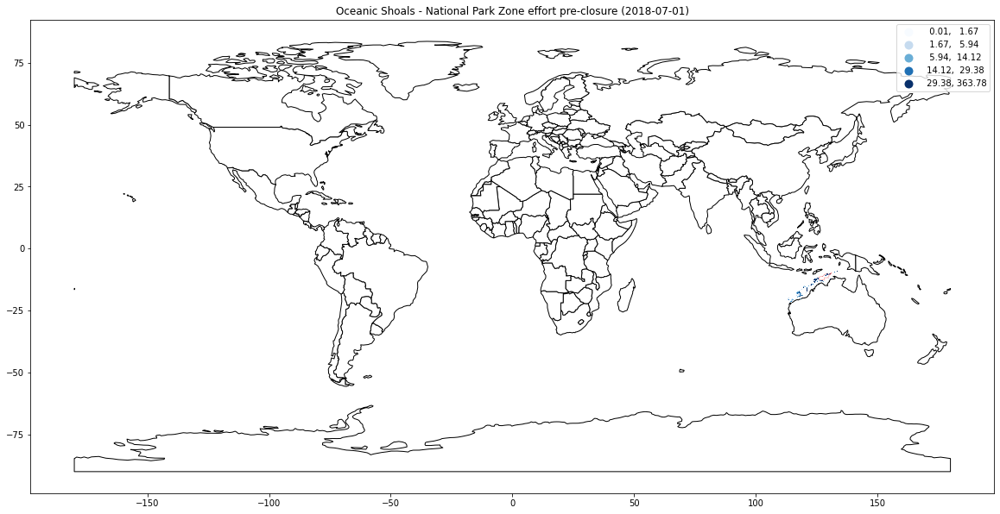

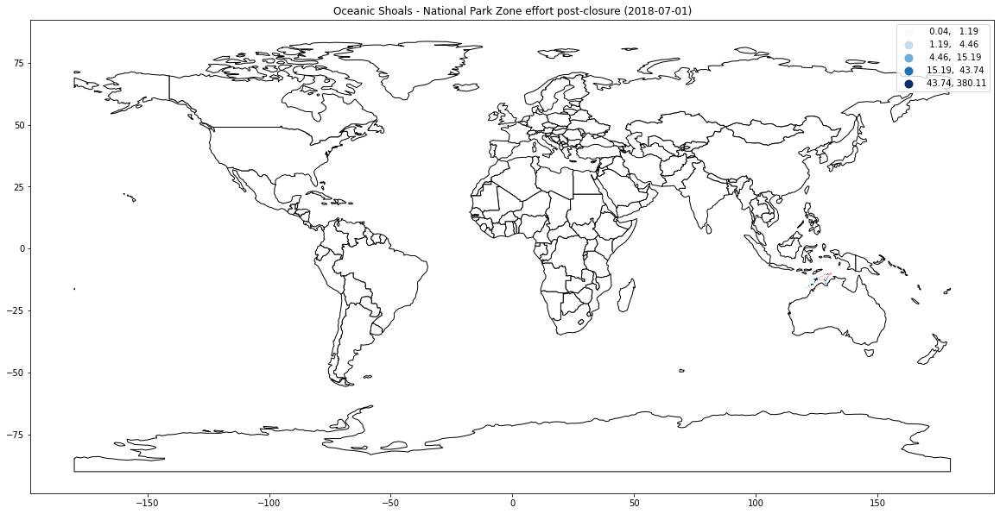

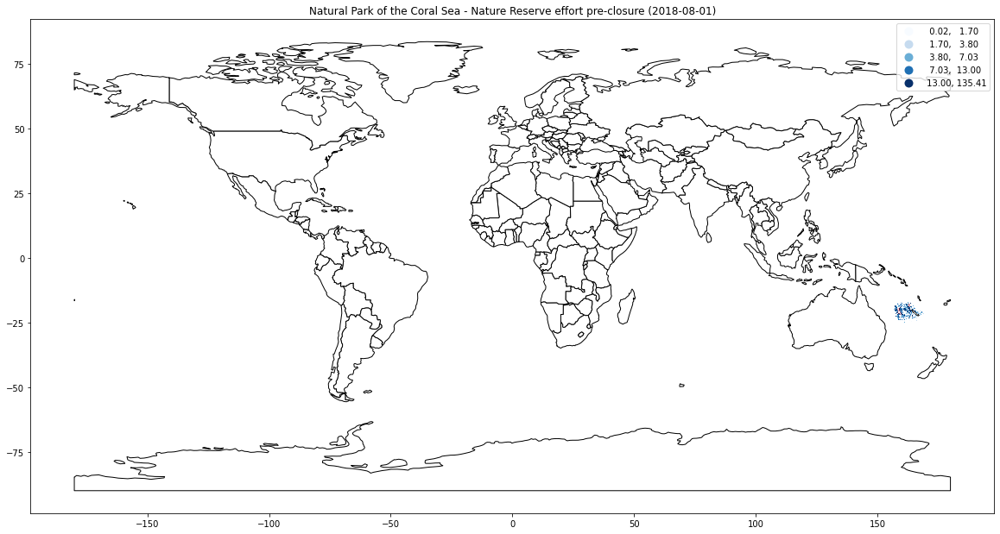

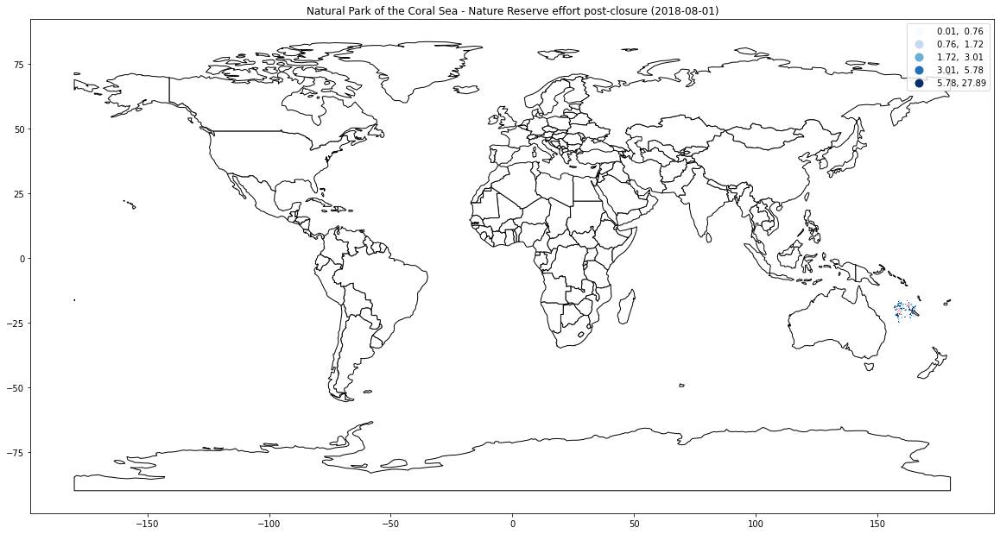

In [26]:
import util
import os

tables = pandas.DataFrame()
summed_tables = pandas.DataFrame()
j = 0
for mpa_id, wdpa_id, name, date in of_interest:
    j += 1
    print(f'\r{j}/{len(of_interest)} {mpa_id} {wdpa_id} {name} {date}                           ', end='')
    mpa = None
    if wdpa_id:
        mpa = mpas[mpas['wdpa_id'] == wdpa_id].dissolve(by='wdpa_id')
    elif mpa_id:
        mpa = mpas[mpas['mpa_id'] == mpa_id].dissolve(by='mpa_id')
    else:
        print(f'no id for {name}, skipping')
        continue
        
    folder = f'plots/mpas/{name}/'
    
    returned = util.analyze_mpa(
        geopoints_sampled, points_by_year, mpa, date, name, verbose=False,
        plot_pre_post=True, folder=folder)
    if returned is not None:
        table, points_of_mpa_ships = returned
        table.insert(0, 'name', name)
        table.insert(1, 'date', date)
        table.insert(2, 'wdpa_id', wdpa_id)
        table.insert(3, 'mpa_id', mpa_id)
        
        
        html_table_blue_light = pretty_html_table.build_table(table, 'blue_light')
    # Save to html file
        with open(folder+'/individual_ships.html', 'w') as f:
            f.write(html_table_blue_light)
        
        tables = tables.append(table)
        
        summed = table.groupby('name').aggregate({
            'name': 'first',
            'wdpa_id': 'first',
            'mpa_id': 'first',
            'date': 'first',
            'mmsi': 'count',
            'in_pre': 'sum',
            'out_pre': 'sum',
            'in_post': 'sum',
            'out_post': 'sum'})
        summed_tables = summed_tables.append(summed)
    else:
        summed_tables = summed_tables.append(
            {'name': mpa.iloc[0]['name'], 'wdpa_id': wdpa_id, 'mpa_id': mpa_id, 'date': date}
            , ignore_index=True)

In [18]:
summed_tables.sort_values('mmsi', ascending=False)

,name,wdpa_id,mpa_id,date,mmsi,in_pre,out_pre,in_post,out_post
0,Phoenix Island Protected Area,555512002,None,2015-01-01,136.0,136247.5240,1.454290e+06,666.0440,2.824647e+06
117,Palau,555622118,68807606,2020-01-01,82.0,257219.6322,2.764867e+05,22729.9473,1.121224e+05
75,South Georgia and South Sandwich Islands [No-T...,555547601,68808365,2012,26.0,0.0000,0.000000e+00,145667.0593,2.956202e+05
33,Ross Sea Region [General Protection Zone (iii)...,555624810,68813308,2017-12-01,22.0,12988.5215,2.880880e+05,2585.1822,1.599393e+05
34,Ross Sea Region [General Protection Zone (ii) ...,555624810,68813307,2017-12-01,22.0,12988.5215,2.880880e+05,2585.1822,1.599393e+05
165,Ross Sea Region [General Protection Zone (i) R...,555624810,9047,2017-12-01,22.0,12988.5215,2.880880e+05,2585.1822,1.599393e+05
58,Coral Sea - National Park Zone,555556875,68808920,2018-07-01,17.0,26292.7518,7.924648e+04,14590.1198,4.680578e+04
77,Terres Australes Françaises [Strict Marine Pro...,345888,68808359,2016-12-16,14.0,79932.2690,4.948200e+03,57154.5740,6.815310e+03
149,Central Eastern - National Park Zone,555556874,14986,2018-07-01,13.0,4271.1189,7.025321e+04,2889.3849,3.801784e+04
26,Revillagigedo - Zona Núcleo/Uso Restringido In...,555629385,68813451,2018-11-30,11.0,2055.2248,7.490157e+04,0.0483,2.805247e+04


In [19]:
tables

,name,date,wdpa_id,mpa_id,mmsi,in_pre,out_pre,in_post,out_post,pre_percent_in,post_percent_in
96,Phoenix Island Protected Area,2015-01-01,555512002,None,440986000,6691.4584,13485.1547,0.0000,34890.8708,0.331644,0.000000
31,Phoenix Island Protected Area,2015-01-01,555512002,None,440239000,4188.8009,15180.6638,0.0000,32516.4440,0.216258,0.000000
69,Phoenix Island Protected Area,2015-01-01,555512002,None,440781000,4105.5361,15257.5515,0.0000,34293.3112,0.212029,0.000000
15,Phoenix Island Protected Area,2015-01-01,555512002,None,416004242,3636.9276,8995.6413,0.0000,34131.3703,0.287901,0.000000
51,Phoenix Island Protected Area,2015-01-01,555512002,None,440624000,3418.1845,16201.1762,0.0000,5201.0624,0.174225,0.000000
77,Phoenix Island Protected Area,2015-01-01,555512002,None,440821000,3394.5436,10365.7356,22.9686,30571.3555,0.246691,0.000751
110,Phoenix Island Protected Area,2015-01-01,555512002,None,441644000,2952.1764,17252.2607,0.0000,30307.2407,0.146115,0.000000
82,Phoenix Island Protected Area,2015-01-01,555512002,None,440894000,2809.4182,10711.1443,137.1694,39641.5335,0.207789,0.003448
57,Phoenix Island Protected Area,2015-01-01,555512002,None,440648000,2757.6457,17800.9135,10.0602,38693.5204,0.134136,0.000260
55,Phoenix Island Protected Area,2015-01-01,555512002,None,440646000,2438.6673,13146.5426,0.0000,32510.1660,0.156473,0.000000


In [27]:
html_table_blue_light = pretty_html_table.build_table(tables, 'blue_light')

# Save to html file
with open('2022/winter/week07/all_mmsi.html', 'w') as f:
    f.write(html_table_blue_light)

In [50]:
summed_tables['in_pre_p'] = summed_tables['in_pre'] / (summed_tables['in_pre'] + summed_tables['out_pre'])
summed_tables['in_post_p'] = summed_tables['in_post'] / (summed_tables['in_post'] + summed_tables['out_post'])
summed_tables = summed_tables.fillna(0)

In [51]:
html_table_blue_light = pretty_html_table.build_table(summed_tables.sort_values('mmsi', ascending=False), 'blue_light')

# Save to html file
with open('2022/winter/week07/in_out_effort_171.html', 'w') as f:
    f.write(html_table_blue_light)

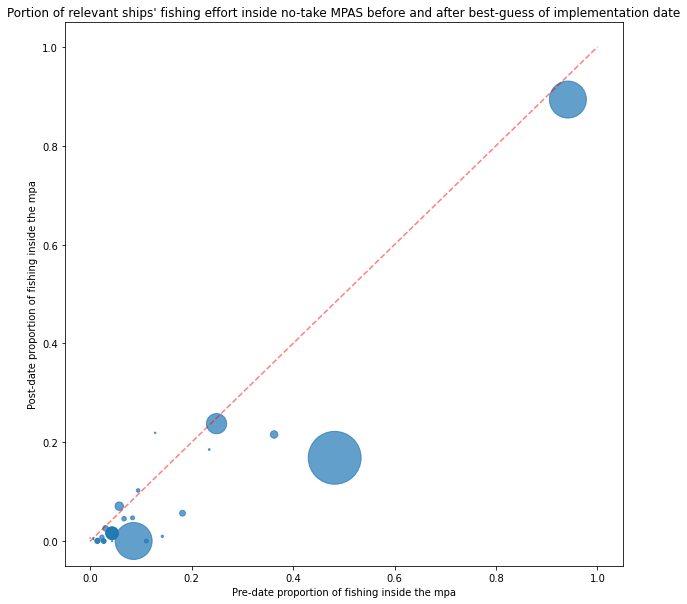

In [52]:
points = summed_tables[(summed_tables['in_pre'] > 0) | summed_tables['in_post'] > 0]
sizes = ((points['in_pre'] + points['in_post']))/100
#sizes = points['mmsi'] * 5
plt.figure(figsize=(10, 10))
plt.plot(np.linspace(0, 1, 100), np.linspace(0, 1, 100), '--', c='red', alpha=0.5)
plt.xlabel('Pre-date proportion of fishing inside the mpa')
plt.ylabel('Post-date proportion of fishing inside the mpa')
plt.title('Portion of relevant ships\' fishing effort inside no-take MPAS before and after best-guess of implementation date')

plt.scatter(points['in_pre_p'], points['in_post_p'], s=sizes, alpha=0.7)

This shows proportion of fishing effort of relevant ships inside 30 MPAs before and after their implementation, scaled by the amount of total fishing effort seen inside those areas (between 2012 and 2020).

Of some 165 MPAs that fit the criteria of being 'no-take' and fully implemented with either an implementation date or, if that is not available, a status year between 2012 and 2020, only these 30 MPAs actually had any fishing effort inside them at all.

Relevent ships are unique mmsi that spent any fishing effort inside the MPA between 2012 and 2020 according to the GFW data.

In [23]:
no_take.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1056 entries, 185 to 20932
Data columns (total 31 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   mpa_id      1056 non-null   int64   
 1   wdpa_id     1056 non-null   int64   
 2   wdpa_pid    851 non-null    object  
 3   name        1056 non-null   object  
 4   country     1056 non-null   object  
 5   sovereign   1056 non-null   object  
 6   designatio  1056 non-null   object  
 7   designat_1  1048 non-null   object  
 8   designat_2  1010 non-null   object  
 9   iucn_categ  871 non-null    object  
 10  status      1056 non-null   object  
 11  status_yea  1056 non-null   int64   
 12  is_mpa      1056 non-null   int64   
 13  implemente  1056 non-null   int64   
 14  implementa  71 non-null     object  
 15  no_take     1056 non-null   object  
 16  no_take_ar  1056 non-null   float64 
 17  rep_m_area  1056 non-null   float64 
 18  calc_m_are  1056 non-null   float64 


In [45]:
no_take = mpas[(mpas['no_take']=='All') & (mpas['implemente'])]
all_no_take = []
of_interest = [
    (None, 555512002, 'Phoenix Island Protected Area', '2015-01-01')
]
# for i, row in no_take[no_take['status_yea'] > 2012].iterrows():
for i, row in no_take.iterrows():
    date = row['implementa']
    if date is None:
        date = str(row['status_yea'])
    of_interest.append(
        (row['mpa_id'], row['wdpa_id'], row['name'], date)
    )


In [47]:
no_take_tables = pandas.DataFrame()
no_take_summed_tables = pandas.DataFrame()
j = 0
for i, row in no_take.iterrows():
    name = row['name']
    mpa_id = row['mpa_id']
    wdpa_id = row['wdpa_id']
    date = row['implementa']
    if date is None:
        date = str(row['status_yea'])
    if date is None:
        print(f'no date for {name}, skipping')
        continue
    j += 1
    print(f'\r{j}/{no_take.shape[0]} {mpa_id} {wdpa_id} {name} {date}                           ', end='')
    mpa = None
    if wdpa_id:
        mpa = mpas[mpas['wdpa_id'] == wdpa_id].dissolve(by='wdpa_id')
    elif mpa_id:
        mpa = mpas[mpas['mpa_id'] == mpa_id].dissolve(by='mpa_id')
    else:
        print(f'no id for {name}, skipping')
        continue
    
    returned = util.analyze_mpa(geopoints_sampled, points_by_year, mpa, date, name=name, verbose=False, plot_pre_post=False)
    if returned is not None:
        table = returned
        table.insert(0, 'name', name)
        table.insert(1, 'date', date)
        table.insert(2, 'wdpa_id', wdpa_id)
        table.insert(3, 'mpa_id', mpa_id)
        no_take_tables = no_take_tables.append(table)
        
        summed = table.groupby('name').aggregate({
            'name': 'first',
            'wdpa_id': 'first',
            'mpa_id': 'first',
            'date': 'first',
            'mmsi': 'count',
            'in_pre': 'sum',
            'out_pre': 'sum',
            'in_post': 'sum',
            'out_post': 'sum'})
        no_take_summed_tables = no_take_summed_tables.append(summed)
    else:
        no_take_summed_tables = no_take_summed_tables.append(
            {'name': mpa.iloc[0]['name'], 'wdpa_id': wdpa_id, 'mpa_id': mpa_id, 'date': date}
            , ignore_index=True)

1056/1056 1 1 Diamond Reef and Salt Fish Tail Reef 1973                                                                                             in 1972 1972                                       

In [50]:
no_take_summed_tables.sort_values('mmsi', ascending=False)[no_take_summed_tables['mmsi'] > 0]

/var/folders/f0/jtfp47nd0h74_sbtnbwhqzgm0000gn/T/ipykernel_37319/2447512033.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  no_take_summed_tables.sort_values('mmsi', ascending=False)[no_take_summed_tables['mmsi'] > 0]


,name,wdpa_id,mpa_id,date,mmsi,in_pre,out_pre,in_post,out_post
299,Phoenix Islands Protected Area,555512002.0,7705427.0,2010,143.0,0.0000,0.0000,139148.3882,4.251377e+06
753,Phoenix Islands,309888.0,4395.0,2006,142.0,0.0000,0.0000,136270.0356,4.236634e+06
275,Palau,555622118.0,68807606.0,2020-01-01,90.0,259994.7634,322033.2471,23655.3386,1.167901e+05
345,Great Barrier Reef - Preservation Zone,2628.0,7700301.0,2004,52.0,0.0000,0.0000,82145.7543,1.656435e+05
212,Great Barrier Reef - Marine National Park Zone,2628.0,68808376.0,2004,52.0,0.0000,0.0000,82145.7543,1.656435e+05
213,Great Barrier Reef - Scientific Research Zone,2628.0,68808375.0,2004,52.0,0.0000,0.0000,82145.7543,1.656435e+05
215,South Georgia and South Sandwich Islands [No-T...,555547601.0,68808365.0,2012,25.0,0.0000,0.0000,145379.3732,2.980725e+05
95,Ross Sea Region [General Protection Zone (iii)...,555624810.0,68813308.0,2017-12-01,19.0,13081.6022,262084.0443,2583.0986,1.442635e+05
96,Ross Sea Region [General Protection Zone (ii) ...,555624810.0,68813307.0,2017-12-01,19.0,13081.6022,262084.0443,2583.0986,1.442635e+05
553,Ross Sea Region [General Protection Zone (i) R...,555624810.0,9047.0,2017-12-01,19.0,13081.6022,262084.0443,2583.0986,1.442635e+05


In [27]:
# html_table_blue_light = pretty_html_table.build_table(no_take_summed_tables.sort_values('mmsi', ascending=False), 'blue_light')

# Save to html file
# with open('2022/winter/week06/in_out_effort_all_no_take.html', 'w') as f:
#    f.write(html_table_blue_light)

## Trying to analyze the individual ships, etc. of the interesting ones

13/27 Prince Edward Islands - Sanctuary Zone 2013                           a 2018-03-19                           

/opt/homebrew/lib/python3.9/site-packages/geopandas/plotting.py:661: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)


27/27 Ross Sea Region [General Protection Zone (i) Ross Sea shelf/slope and Balleny Islands] 2017-12-01                           

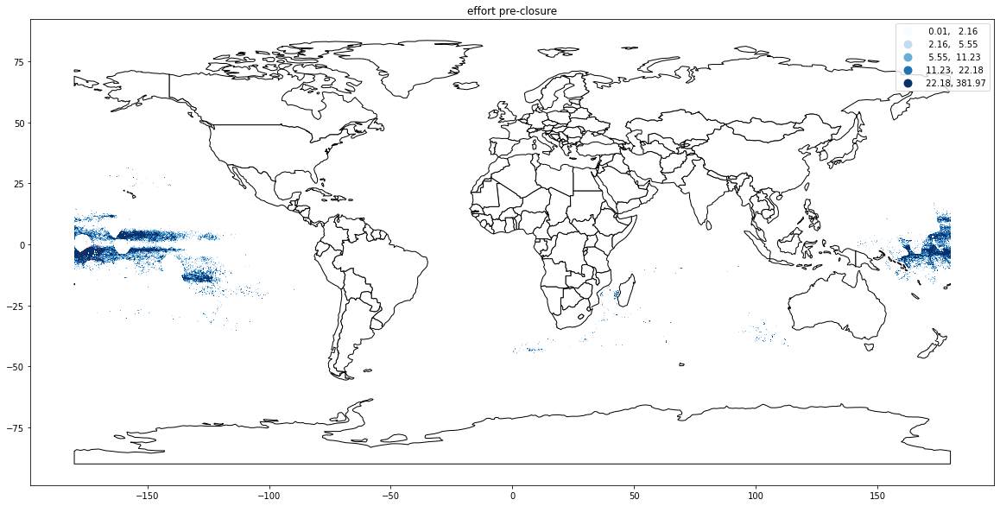

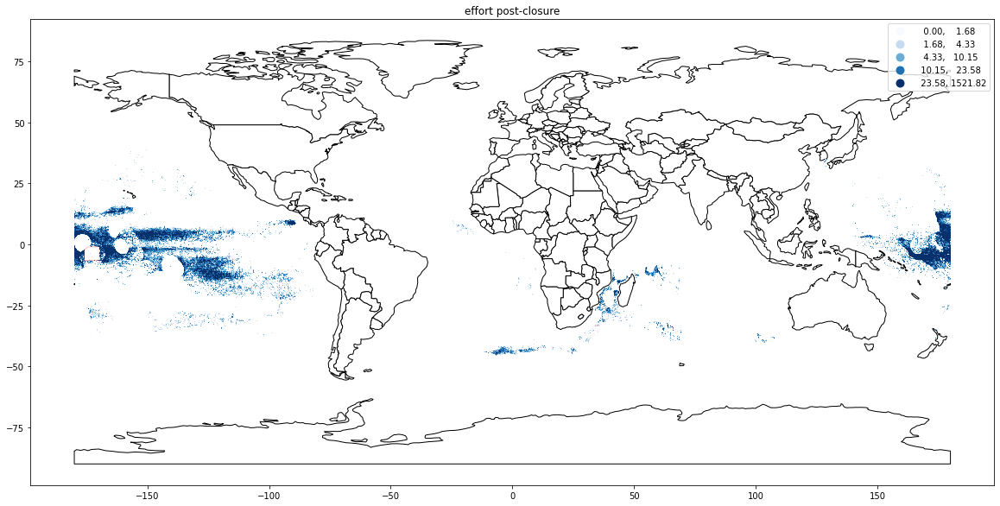

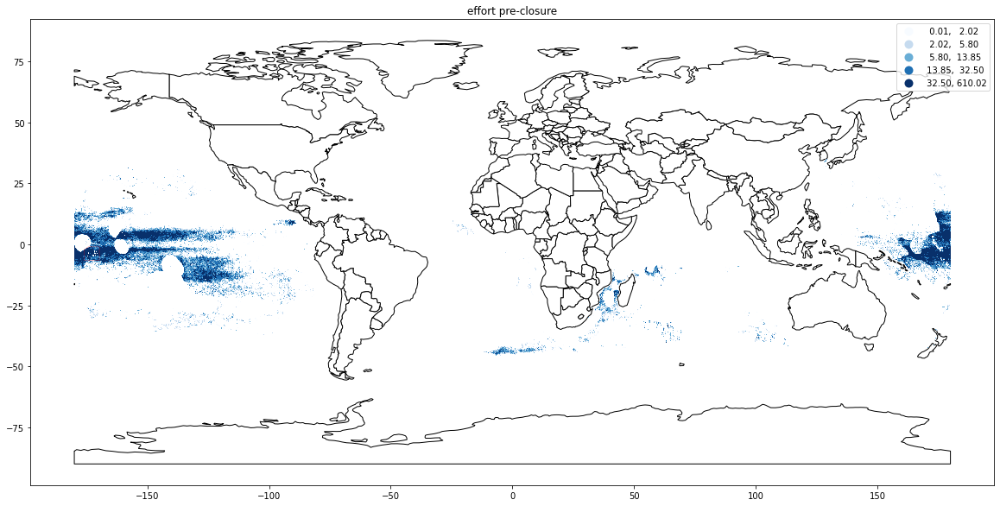

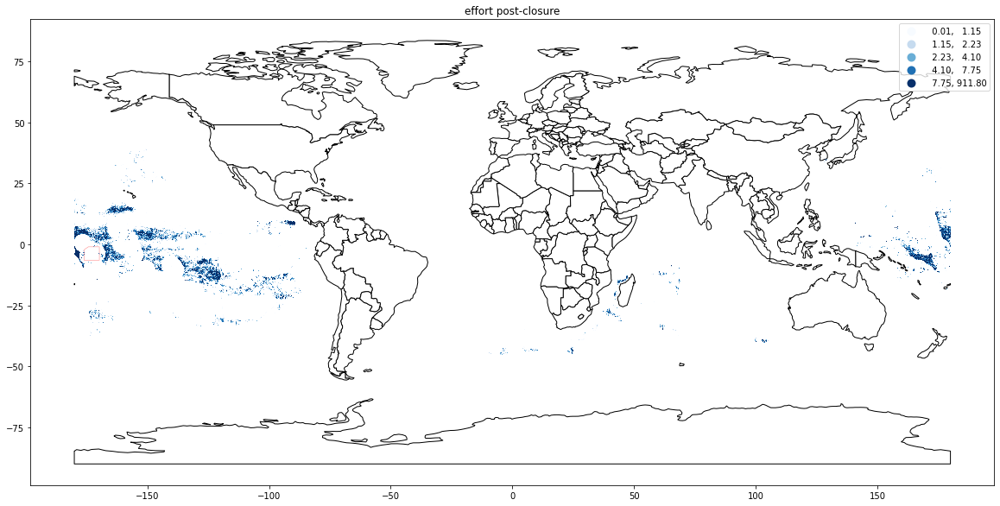

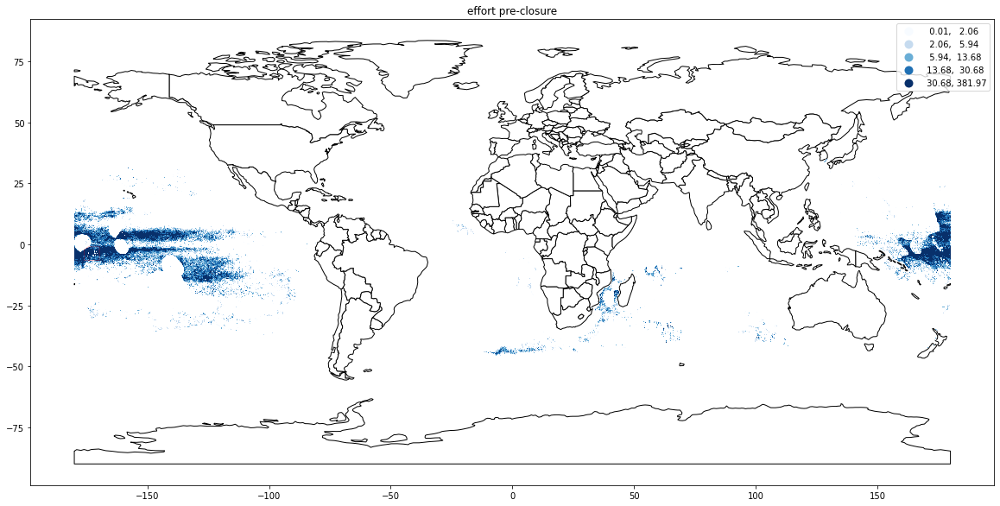

...

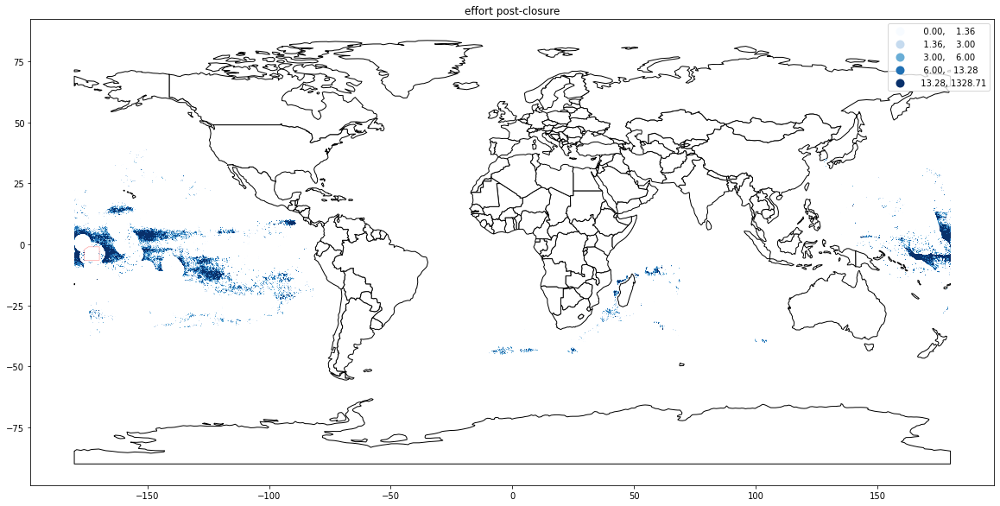

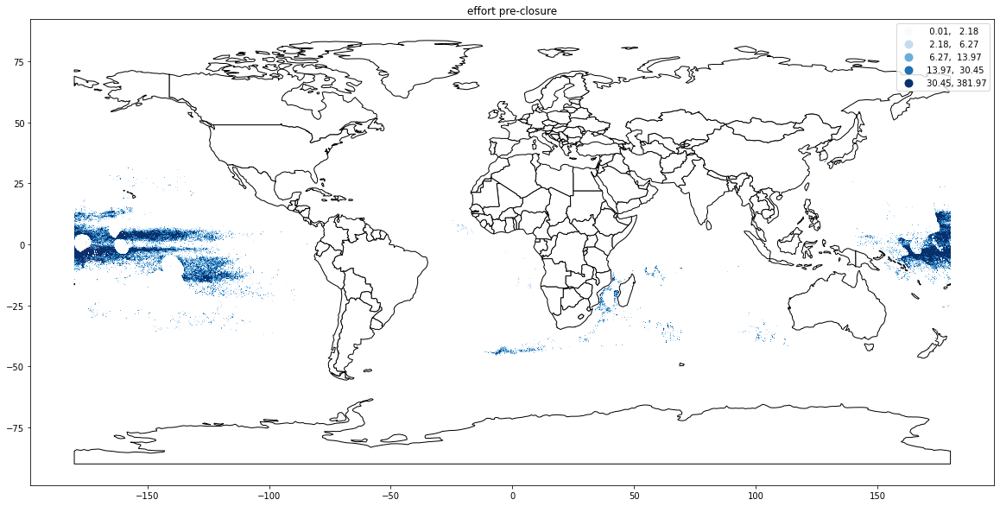

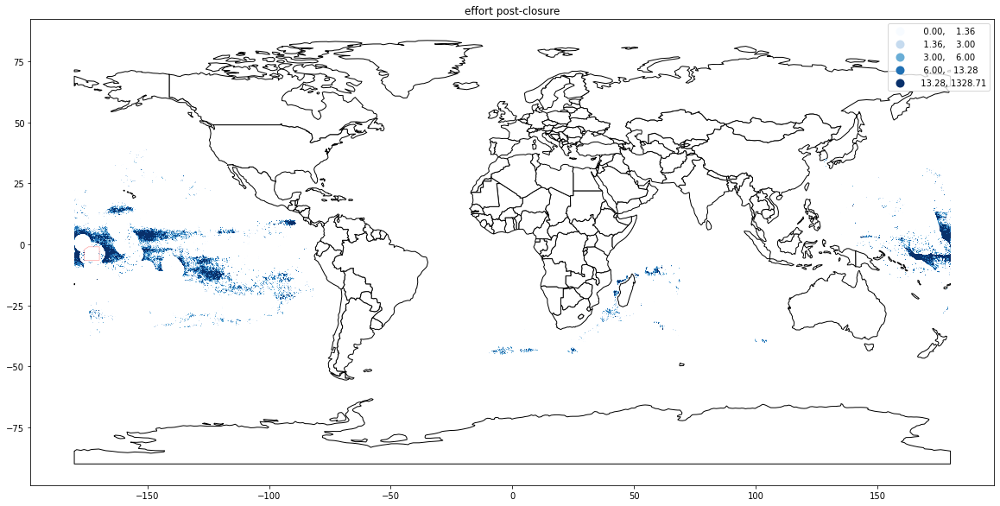

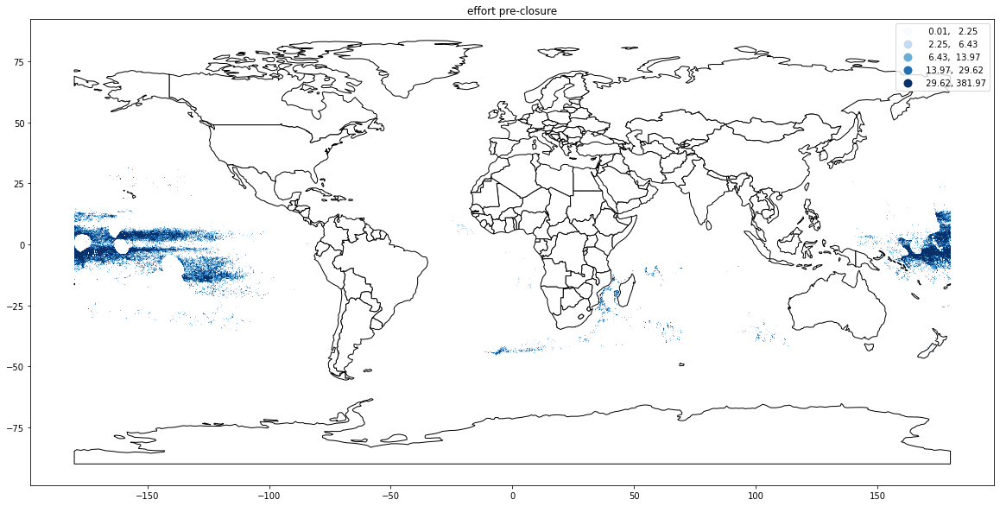

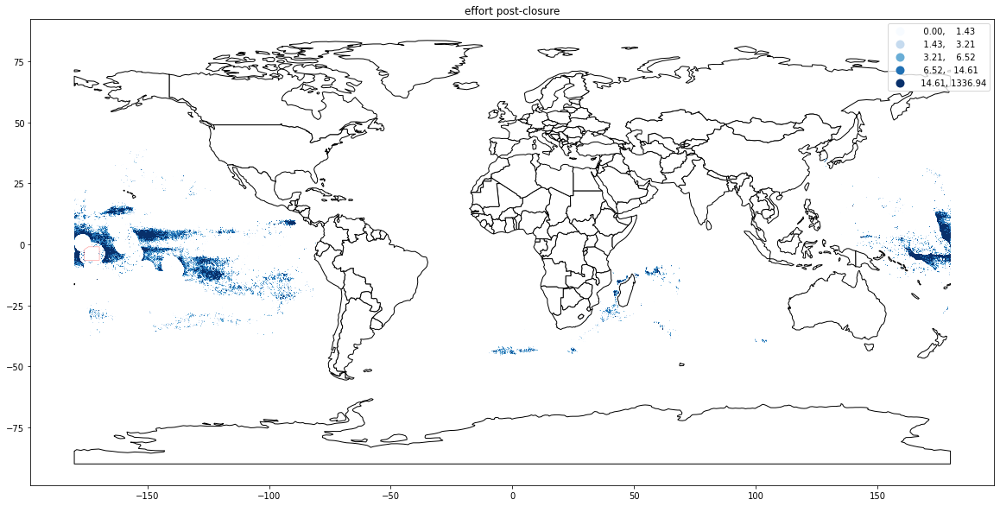

In [83]:
# mpas_with_pre = summed_tables[(summed_tables['in_pre'] > 0)]

mpas_with_pre_ = []
for _, row in mpas_with_pre.iterrows():
    mpa = None
    if row['wdpa_id']:
        mpa = mpas[mpas['wdpa_id'] == wdpa_id].dissolve(by='wdpa_id')
    elif row['mpa_id']:
        mpa = mpas[mpas['mpa_id'] == mpa_id].dissolve(by='mpa_id')
    else:
        print(f'no id for {name}, skipping')
        continue
    mpas_with_pre_.append((mpa, row['date'], row['name']))

j = 0
for mpa, date, name in mpas_with_pre_:
    j += 1
    print(f'\r{j}/{len(mpas_with_pre_)} {name} {date}                           ', end='')
    util.analyze_mpa(geopoints_sampled, points_by_year, mpa, date, plot_pre_post=True, verbose=False)

In [30]:
# test_row = mpas_with_effort_in_pre.iloc[1, :]
# mpa_id = test_row['mpa_id']
# wdpa_id = test_row['wdpa_id']



# mpa = None
# if wdpa_id is not None:
#     mpa = mpas[mpas['wdpa_id'] == wdpa_id]
# else:
#     mpa = mpas[mpas['mpa_id'] == mpa_id]
# if mpa is None:
#     print("mpa can't be found")
#     #return

# points_of_mpa_ships = util.points_of_interest(
#     geopoints_sampled, points_by_year, mpa, date)
# if points_of_mpa_ships is None:
#     print('no points')
#     #return

# geopoints_ = util.convert_to_geo(points_of_mpa_ships, box=True)
# geopoints_['pre'] = geopoints_['date'] < date
# # fastest way to do this is just this whole join:
# geopoints_['in_mpa'] = ~geopandas.sjoin(
#     geopoints_, mpa[['geometry']], how='left', predicate='within')['index_right'].isnull()


<AxesSubplot:>

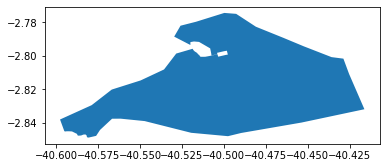

In [76]:
mpas_with_pre_[0][0].plot()

In [39]:
# def plot_effort(effort, window=1):
#     x = effort['date']
#     y = effort['fishing_hours']
#     z = np.zeros(len(y) - window)
#     for i in range(len(y) - window):
#         z[i] = sum(y[i:i+window])/window
#     plt.plot(x[:-window], z)

(167, 8)
(14952, 8)


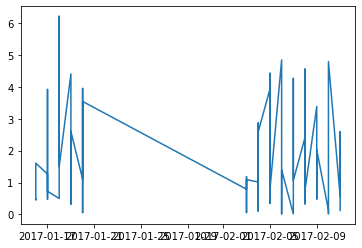

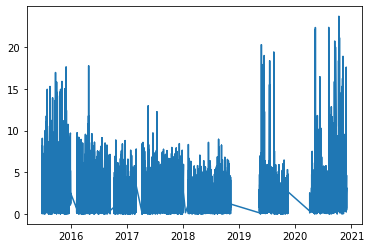

In [41]:
# for mmsi in set(geopoints_['mmsi']):
#     in_points = geopoints_[(geopoints_['mmsi'] == mmsi) & geopoints_['in_mpa']].sort_values('date', ascending=True)
#     print(in_points.shape)
#     out_points = geopoints_[(geopoints_['mmsi'] == mmsi) & ~geopoints_['in_mpa']].sort_values('date', ascending=True)
#     print(out_points.shape)
#     plot_effort(in_points, window=1)
#     plt.show()
#     plot_effort(out_points, window=1)
#     break

In [34]:
mpas[mpas['name'].str.contains("Kiribati")]

,mpa_id,wdpa_id,wdpa_pid,name,country,sovereign,designatio,designat_1,designat_2,iucn_categ,status,status_yea,is_mpa,implemente,implementa,no_take,no_take_ar,rep_m_area,calc_m_are,rep_area,calc_area,gov_type,mgmt_auth,mgmt_plan_,fishing,access,constancy,permanence,SHAPE_Leng,SHAPE_Area,geometry
9293,68808464,0,None,Kiribati,KIR,KIR,Shark Sanctuary,Shark Sanctuary,None,None,Designated,2015,0,1,None,Not Reported,0.0,0.0,0.0,0.0,0.0,None,None,None,Some Restrictions,Unknown,Unknown,Unknown,157.972062,280.660803,"MULTIPOLYGON (((-179.99655 -3.75203, -180.0000..."


running sjoin... 
found 9207 sampled points in the mpa from 560 ships
found 5538714 points of mpa ships


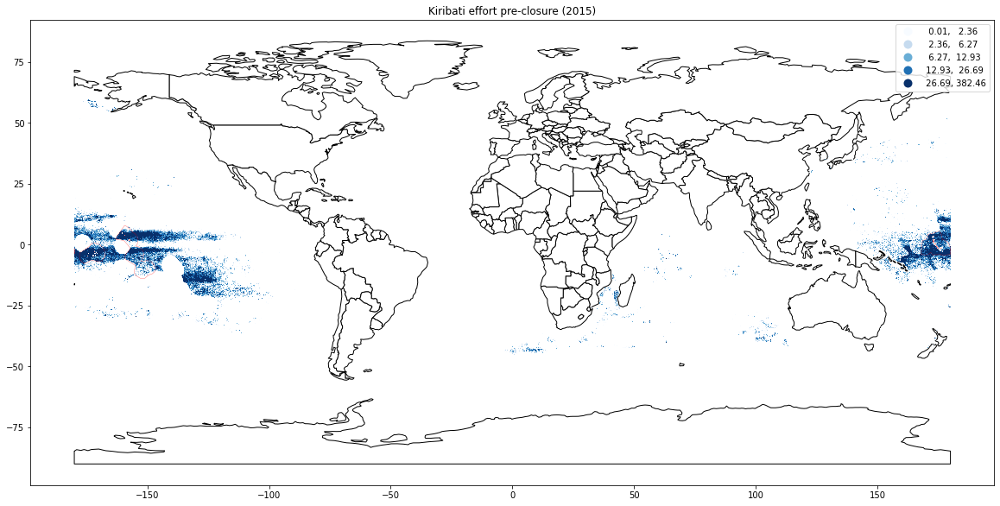

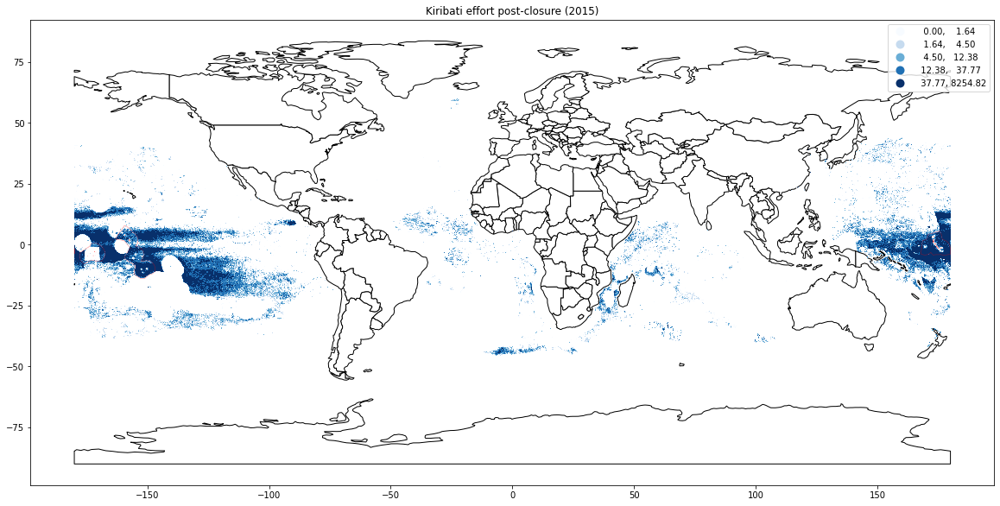

In [38]:
kiribati = mpas[mpas['name'].str.contains("Kiribati")]
kiribati_info = util.analyze_mpa(geopoints_sampled, points_by_year, kiribati, '2015', 'Kiribati', verbose=True, plot_pre_post=True)

In [42]:
kiribati_info.sort_values('in_pre', ascending=False)

,mmsi,in_pre,out_pre,in_post,out_post,pre_percent_in,post_percent_in
383,440986000,13341.1718,6835.4413,1234.3765,33656.4943,0.661220,0.035378
315,440624000,10380.4622,9238.8985,2092.3530,3108.7094,0.529093,0.402293
377,440950000,10192.0436,10278.2598,0.0000,25.0887,0.497894,0.000000
314,440623000,9819.8642,9748.1005,6681.4904,27114.5196,0.501834,0.197701
300,440522000,9566.1762,10029.6395,1550.4383,26782.0289,0.488174,0.054723
309,440595000,9256.3594,10609.4459,1127.6267,35106.6928,0.465944,0.031120
323,440648000,9243.8464,11314.7128,8955.3018,29748.2788,0.449635,0.231382
465,529415000,9219.7191,5708.9313,0.0000,0.0000,0.617586,NaN
357,440846000,9084.5461,9736.6677,7130.3995,29227.1397,0.482676,0.196119
342,440781000,8954.4164,10408.6712,7864.9709,26428.3403,0.462448,0.229344


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 20933 entries, 0 to 20932
Data columns (total 31 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   mpa_id      20933 non-null  int64   
 1   wdpa_id     20933 non-null  int64   
 2   wdpa_pid    18866 non-null  object  
 3   name        20933 non-null  object  
 4   country     20933 non-null  object  
 5   sovereign   20933 non-null  object  
 6   designatio  20846 non-null  object  
 7   designat_1  20535 non-null  object  
 8   designat_2  20467 non-null  object  
 9   iucn_categ  18911 non-null  object  
 10  status      20933 non-null  object  
 11  status_yea  20933 non-null  int64   
 12  is_mpa      20933 non-null  int64   
 13  implemente  20933 non-null  int64   
 14  implementa  322 non-null    object  
 15  no_take     20933 non-null  object  
 16  no_take_ar  20933 non-null  float64 
 17  rep_m_area  20933 non-null  float64 
 18  calc_m_are  20933 non-null  float64 
 